# GTEx eQTL detection: trans- pipeline for consortium paper

This notebook summarizes the trans- associations that we draw from the GTEx data, for the consortium paper.

All the relevant code for this pipeline can be viewed at:

https://github.com/bee-hive/RNAseq_pipeline/tree/master/Scripts/eqtls/trans/gtex/consortium/

The table of contents for this notebook:

## 1. All-by-all trans associations, with PEER increments of 5

### 1.1 MatrixEQTL scripts for all-by-all trans tests

### 1.2 FDR calibration across the whole dataset

### 1.3 Cross-mapping filter and final eQTL list

### 1.4 Summary of the final set of trans-eQTLs at FDR 0.1

## 2. Additional trans-lists from MatrixEQTL

### 2.1 Intrachromosomal QTLs

### 2.2 Three subsetting methods: cis-eQTLs, trait-associated SNPs (GWAS hits), and PLINK-pruned set based on LD

### 2.3 Summary of the final set of trans-eQTLs at FDR 0.1

## 3. Results gallery

### Trans-eQTLs in 9q22 locus in thyroid

### Enrichment of trans-eQTLs among best cis-eQTLs

## 4. Additional results for the revision

### 4.1 Effects of increasing PEER factors in terms of trans-eQTL detection

### 4.2 AA/EA segregation runs for the trans hits

### 4.3 MR - Causal inference framework on GTEx data

## 1. All-by-all trans associations

The simplest way of looking for trans-eQTLs are to just plug in all gene expression values and all SNPs and looking for associations. However, we need to be more careful for trans- tests to make sure that we are properly filtering out false positives, since the weaker signal and higher number of tests can lead to mapping artifacts overestimating the strength of association.

We are going to follow these steps:

1. Filter genes based on mappability - we use a threshold of 0.8.
2. Filter SNPs based on RepeatMasker (not belonging to any annotated repeat regions) - this part covered in the Genotype notebook.
3. Run MatrixEQTL, while making sure to filter snps based on tissue-specific MAF of 0.05.
4. Cross out any SNP-gene pairs for which there is potential cross-mapping - This notebook will get into more detail for this later.

Here are some highlights of our pipeline:

- We used GTEx v6p release, since this release has fixed some problems with expression quantification in regions where mapping is ambiguous.

- Gene mappability, which in this case is the measure of how much ambiguity there exists across exons and UTRs in a gene in terms of read mapping, can be found in:

<code>/tigress/BEE/RNAseq/Data/Resources/annotations/avg_mappability_Exon_UTR.txt</code>

- Repeatmasker raw data, which annotates all repeat regions in human genome version hg19 (including SINEs, LINEs, transposons, etc.), can be found in :

<code>/tigress/BEE/RNAseq/Data/Resources/RepeatMasker/</code>

- MatrixEQTL runs, in addition to the tissue-specific PEER factors, also include a set of 5 covariates: First 3 genotype PCs, sex and genotyping platform. Either sex or genotyping platform is not included if there is only one type (i.e. testis, cervix, etc.)

- The Cross-mapping filtering part comes from:

<code>/tigress/BEE/RNAseq/Data/Resources/annotations/pairwise_conflict.txt</code>

This file has 23727385 pairs that are potentially cross-mapping

The reason step point 4 belongs after running MatrixEQTL is because if we were to apply this filter beforehand, we will need a gene-specific snp set for our tests, significantly increasing the number of iterations and severely slowing our pipeline as a consequence.

As it can be seen, we put a lot of filters in place to make sure that we get a very conservative set of trans- calls, in contrast to the cis- call that have been made both by the consortium and by us independently.

### 1.1 MatrixEQTL scripts for all-by-all trans tests

- More details about the trans-eQTL mapping procedure:

#### Gene set

Used the cis-eQTL analysis gene set shared by Joe:

<code>
In della: /tigress/BEE/RNAseq/Data/Resources/annotations/gtex.v6p.genes.with.without.cis.eqtls.tested.txt

In hhpc: /scratch0/battle-fs1/heyuan/trans/response_to_review/trans-eQTLs/gene_sets/gtex.v6p.genes.with.without.cis.eqtls.tested.txt

Number of genes : 24411
Number of ‘protein-coding’ genes : 18394
Number of ‘lincRNA’ genes : 6017
</code>

#### SNP set

Genotype file location - 
<code>
In della: /tigress/BEE/RNAseq/Data/Genotype/gtex/imputed_genotypes/allelic_dosage/continuous/

In hhpc: /scratch0/battle-fs1/heyuan/trans/data/Genotype_continuous/
</code>

They were obtained by reading in dosage values directly from the consortium genotype files (they have been corrected from the first-pass) - 
<code>
GTEx_Analysis_2015-01-12_OMNI_2.5M_5M_450Indiv_allchr_genot_imput_info04_maf01_HWEp1E6_ConstrVarIDs.vcf.gz
</code>

#### New Trans-eQTL mapping pipeline

#### Step 1: Run MatrixEQTL, for all-by-all trans pairs, with incremental PEER correction.

#### Brief summary of the mapping procedure :

- Read in all gene expression matrix, genotype matrix, gene positions, and SNP positions.
- Filter genes by mappability cutoff of 0.8.
- Filter SNPs by tissue-specific MAF of 0.05.
- Read in covariates and prepare covariate matrices with number of PEER factors in increments of 5 (genotype PCs 1-3, sex and genotype platform are included in all cases).
- Run Matrix eQTL
- Output trans-eQTL mapping at p-value threshold of 1e-5
- Note that separation of joint, protein-coding and lincRNA sets doesn’t happen here - it happens in the FDR calibration step.

Given the expression matrices, we can run the trans-eQTL mapping script:

In [ ]:
%%bash
export proj='/tigress/BEE/RNAseq'
# gtex gct
python $proj/Scripts/eqtls/trans/gtex/consortium/trans_matrix_eqtl_wrapper.py \
/Data/Expression/gtex/hg19/GTEx_phs000424_v6p/normalized/ \
_v6p_consortium_autosomes_normalized.txt \
/Output/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments/ \
/Output/joblogs/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments/ \
trans_matrix_eqtl_PEER_increments_final.R 2.5e8 20 30

After running the above script, we have raw output files in Della, located at:

<code>
/tigress/BEE/RNAseq/Output/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments
Total data disk usage: ~14G
</code>

#### Outputs : Number of genes tested, SNPs tested, Total Number of tests, P-value histograms, eQTL summary statistics below p-value threshold of 1e-5


### 1.2 FDR calibration across the whole dataset

After running the MatrixEQTL for all SNP-gene pairs, we collect the overall statistics across parallel runs, calibrate FDR based on joint, protein-coding and lincRNA test sets and then write the list of significant eQTLs.

#### Brief summary of the FDR calibration procedure :

- Read in the tissue-specific expression and annotation file for categorizing genes into ‘protein-coding’ and ‘lincRNA’ sets.
- Read in all data files from parallel runs of Matrix eQTL, and accumulate the following numbers: Number of tests, P-value histograms (in bins of 0.01), and eQTL summary stats.
- Separate the gene set into ‘protein-coding’ and ‘lincRNA’, and calculate the number of tests accordingly for them
- Run Benjamini-Hochberg on joint, protein-coding and lineRNA test sets with the respective number of tests
- Output the list with updated FDR values by tissue and by test set


In [ ]:
%%bash
# gtex gct
python $proj/Scripts/eqtls/trans/gtex/consortium/MatrixEQTL_FDR_control_wrapper_PEER_increments.py \
/Output/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments/ \
/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/all-by-all-PEER-increments/ \
all-by-all-PEER-increments MatrixEQTL_FDR_control_PEER_increments_final.R \
/Output/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments/tissue_list.txt

Location of resulting eQTL lists in Della :

<code>
/tigress/BEE/RNAseq/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/all-by-all-PEER-increments/eqtl_list/
Total data disk usage: ~9.6G
</code>

#### Outputs : Three sets of summary statistics - joint, protein-coding, and lincRNA trans-eQTL sets

#### It seems like the multiple testing burden is not increased very heavily by looking at all of protein-coding and lincRNA genes. We decided to simply take the joint set for downstream analysis.

### 1.3 Cross-mapping filter and final eQTL list

#### Brief summary of the procedure : 

- Read in the cross-mapping gene pair reference.
- Check, for each SNP, whether there is a gene within a distance threshold (100kb is used) that has potential cross-mapping with the target gene, and if it does, remove from the list.
- Output at FDR threshold of 0.1, and also output at p-value threshold of 1e-5, only for the full PEER-factor corrected, joint analysis set (for Ben’s cross-tissue analysis). Also output a list of trans-eQTLs detected in tests with low number of PEER factors but not in full set of PEER factors (for Princy’s analysis).

Note: tissue_list.txt file has the set of 44 tissues that are being analyzed for the consortium - you can alter this file to change the set of tissues to output the final list.

In [ ]:
%%bash
# gtex gct
python $proj/Scripts/eqtls/trans/gtex/consortium/Final_trans_list_wrapper.py \
/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/all-by-all-PEER-increments/ \
1e5 /Output/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments/tissue_list.txt

Location of resulting eQTL lists in Della :

<code>
/tigress/BEE/RNAseq/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/all-by-all-PEER-increments/eqtl_list_post_crossmapping/
Total data disk usage: 58M, when only eQTLs with FDR < 0.5 are saved.
</code>

### 1.4 Summary of the final set of trans-eQTLs at FDR 0.1

<code>
Number of trans-eQTLs at FDR 0.1 : 673
(510 at FDR 0.05)
Number of trans-eGenes at FDR 0.1 : 93
(50 at FDR 0.05)
Number of unique trans-eVariants at FDR 0.1 : 602
(441 at FDR 0.05)
Number of tissues at FDR 0.1 : 16
(also 16 in the previous iteration - We have 12 at FDR 0.05)
</code>


- Number of new trans-eQTLs not previously detected: 115 - Note that the most significant set of additions are in testis - the result is mostly unchanged in other tissues.
- Number of trans-eQTLs from previous iteration that are not included: 34.

#### trans-eQTLs from previous iteration ("preprint set") that are no longer in the joint set:

<code>
cellstransformedfibroblasts_ENSG00000162913.9_rs60307965 
colontransverse_ENSG00000049246.10_rs2028275 
muscleskeletal_ENSG00000206384.6_rs75674648 
nervetibial_ENSG00000117410.9_rs6007631 
skinsunexposedlowerleg_ENSG00000175634.10_rs76942982 
skinsunexposedlowerleg_ENSG00000158201.5_rs7746836 
skinsunexposedlowerleg_ENSG00000166321.9_rs7683255 
skinsunexposedlowerleg_ENSG00000048140.13_rs9948985 
skinsunexposedlowerleg_ENSG00000188517.10_rs9511151 
skinsunexposedlowerleg_ENSG00000188517.10_rs9507287 
testis_ENSG00000170454.5_rs192710288 
thyroid_ENSG00000211789.2_rs12342436 
thyroid_ENSG00000187608.5_rs4142913 
thyroid_ENSG00000187608.5_rs4142914 
thyroid_ENSG00000106123.7_rs4896168 
thyroid_ENSG00000132470.9_rs16908638 
thyroid_ENSG00000187608.5_rs10517676 
thyroid_ENSG00000187608.5_rs10023422 
thyroid_ENSG00000112379.8_rs2120262 
thyroid_ENSG00000132470.9_rs12777352 
thyroid_ENSG00000108826.11_rs2665917 
thyroid_ENSG00000162482.4_rs7786395 
thyroid_ENSG00000150977.9_rs55914535 
thyroid_ENSG00000112379.8_rs894672 
thyroid_ENSG00000112379.8_rs7848950 
thyroid_ENSG00000112379.8_rs1348386 
thyroid_ENSG00000112379.8_rs7849497 
thyroid_ENSG00000112379.8_rs3021523 
thyroid_ENSG00000112379.8_rs7046645 
thyroid_ENSG00000189043.5_rs12593758 
thyroid_ENSG00000112379.8_rs10983975 
thyroid_ENSG00000112379.8_rs7024345 
thyroid_ENSG00000112379.8_rs6478423 
thyroid_ENSG00000189043.5_rs11635416
</code>

#### Number of trans-eQTLs per tissue :

<code>
"adiposesubcutaneous" 7
"adrenalgland" 1
"arteryaorta" 1
"brainputamenbasalganglia" 11
"cellstransformedfibroblasts" 10
"colontransverse" 10
"esophagusmucosa" 11
"lung" 2
"muscleskeletal" 43
"pancreas" 12
"skinnotsunexposedsuprapubic" 1
"skinsunexposedlowerleg" 16
"testis" 290
"thyroid" 229
"vagina" 27
"wholeblood" 2
</code>

## 2. Additional trans-lists from MatrixEQTL

In this section, we obtain additional set of QTLs for various additional analysis that helps us characterizes the GTEx  eQTLs. Namely, we obtain the intrachromosomal trans-eQTLs (> 5MB from the TSS), and 3 types of subsetting for the variant set:

- cis-eQTLs, as identified by the consortium:

<code>/tigress/BEE/eQTLs/Data/References/GTEx/v6p_fastQTL_FOR_QC_ONLY/*_Analysis.v6p.FOR_QC_ONLY.snpgenes.txt.gz</code>

- trait-associated SNPs (GWAS hits):

<code>/tigress/BEE/RNAseq/Data/Resources/annotations/gwas_catalog_v1.0.1-associations_e84_r2016-06-12.tsv</code>

- PLINK-pruned set based on LD, using the parameter set:

<code>/tigress/BEE/tools/plink --bfile /tigress/BEE/gtex/data/genotype/imputed_genotypes/plink/GTEx_Analysis_2015-01-12_OMNI_2.5M_5M_450Indiv_allchr_genot_imput_info04_maf05_HWEp1E6_dbSNPIDs.chr1 --indep 50 5 2

mv plink.prune.in chr1.txt
</code>
repeated from chrs 1 to 22 and the list saved at:
<code>/tigress/BEE/RNAseq/Data/Genotype/gtex/imputed_genotypes/allelic_dosage/continuous/subset_SNPs/ld-subset/master/</code>

### 2.1 Intrachromosomal QTLs

In this run, we take the set of SNP-gene pairs that are distant (>5MB from the TSS), and see if the amount of trans- signal is significantly different from the cis- and trans- eQTL signal. The following scripts are comparable to the steps described in sections 1.1, 1.2 and 1.3:

In [ ]:
%%bash
#mkdir /tigress/BEE/eQTLs/Output/trans-mapping/trans-eQTLs/MatrixEQTL/intrachromosomal

python $proj/Scripts/eqtls/trans/gtex/consortium/trans_matrix_eqtl_wrapper.py \
/Data/Expression/gtex/hg19/GTEx_phs000424_v6p/normalized/ \
_v6p_consortium_autosomes_normalized.txt \
/Output/trans-mapping/gtex/MatrixEQTL/intrachromosomal/ \
/Output/joblogs/trans-mapping/gtex/MatrixEQTL/intrachromosomal/ \
trans_matrix_eqtl_intrachromosomal_final.R 5e6 1 6

python $proj/Scripts/eqtls/trans/gtex/consortium/MatrixEQTL_FDR_control_wrapper.py \
/Output/trans-mapping/gtex/MatrixEQTL/intrachromosomal/ \
/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/intrachromosomal/ \
intrachromosomal MatrixEQTL_FDR_control_intrachromosomal_final.R \
all

Rscript $proj/Scripts/eqtls/trans/gtex/consortium/Final_trans_list_intrachrom.R \
$proj/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/intrachromosomal/ 1e5

In [ ]:
%%bash
#mkdir /tigress/BEE/eQTLs/Output/trans-mapping/trans-eQTLs/MatrixEQTL/intrachromosomal_1MB

python $proj/Scripts/eqtls/trans/gtex/consortium/trans_matrix_eqtl_wrapper.py \
/Data/Expression/gtex/hg19/GTEx_phs000424_v6p/normalized/ \
_v6p_consortium_autosomes_normalized.txt \
/Output/trans-mapping/gtex/MatrixEQTL/intrachromosomal_1MB/ \
/Output/joblogs/trans-mapping/gtex/MatrixEQTL/intrachromosomal_1MB/ \
trans_matrix_eqtl_intrachromosomal_final.R 1e6 1 22

python $proj/Scripts/eqtls/trans/gtex/consortium/MatrixEQTL_FDR_control_wrapper.py \
/Output/trans-mapping/gtex/MatrixEQTL/intrachromosomal/ \
/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/intrachromosomal/ \
intrachromosomal MatrixEQTL_FDR_control_intrachromosomal_final.R \
all

Rscript $proj/Scripts/eqtls/trans/gtex/consortium/Final_trans_list_intrachrom.R \
$proj/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/intrachromosomal/ 1e5

Final list of intrachromosomal eQTLs post cross-mapping:

<code>/tigress/BEE/RNAseq/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/intrachromosomal</code>

### 2.2 Three subsetting methods: cis-eQTLs, trait-associated SNPs (GWAS hits), and PLINK-pruned set based on LD

For the consortium paper, we carry out three types of subsetting runs: top cis-SNPs, GWAS SNPs, and LD-pruned SNPs. The following scripts are also comparable to the steps 1.1, 1.2 and 1.3.

In [ ]:
%%bash
#mkdir /tigress/BEE/eQTLs/Output/trans-mapping/trans-eQTLs/MatrixEQTL/subset_runs

python $proj/Scripts/eqtls/trans/gtex/consortium/trans_matrix_eqtl_wrapper.py \
/Data/Expression/gtex/hg19/GTEx_phs000424_v6p/normalized/ \
_v6p_consortium_autosomes_normalized.txt \
/Output/trans-mapping/gtex/MatrixEQTL/subset_runs/ \
/Output/joblogs/trans-mapping/gtex/MatrixEQTL/subset_runs/ \
trans_matrix_eqtl_subset_runs_final.R 2.5e8 1 22

Rscript $proj/Scripts/eqtls/trans/gtex/consortium/MatrixEQTL_FDR_control_subset_runs_final.R \
$proj/Output/trans-mapping/gtex/MatrixEQTL/subset_runs/ \
$proj/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/subset_runs/

Rscript $proj/Scripts/eqtls/trans/gtex/consortium/Final_trans_list_subset.R \
$proj/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/intrachromosomal/ 1e5


Final list of intrachromosomal eQTLs post cross-mapping:

<code>/tigress/BEE/RNAseq/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/subset_runs</code>

### 2.3 Summary of the final set of trans-eQTLs at FDR 0.1

<code>
- Intrachromosomal run:
Number of trans-eQTLs at FDR 0.1 : 320
(261 at FDR 0.05)
Number of trans-eGenes at FDR 0.1 : 33
(12 at FDR 0.05)
Number of unique trans-eVariants at FDR 0.1 : 284
(236 at FDR 0.05)
Number of tissues at FDR 0.1 : 10

"adiposesubcutaneous" 2
"brainhypothalamus" 2
"brainputamenbasalganglia" 2
"cellstransformedfibroblasts" 17
"esophagusmucosa" 184
"lung" 37
"skinsunexposedlowerleg" 12
"testis" 30
"thyroid" 17
"wholeblood" 17

- Cis-SNP subsetting run:
Number of trans-eQTLs at FDR 0.1 : 50
(43 at FDR 0.05)
Number of trans-eGenes at FDR 0.1 : 33
(27 at FDR 0.05)
Number of unique trans-eVariants at FDR 0.1 : 41
(35 at FDR 0.05)
Number of tissues at FDR 0.1 : 17

"adiposesubcutaneous" 7
"adrenalgland" 1
"braincerebellarhemisphere" 1
"braincerebellum" 1
"brainnucleusaccumbensbasalganglia" 5
"breastmammarytissue" 4
"cellstransformedfibroblasts" 5
"esophagusmucosa" 2
"esophagusmuscularis" 1
"muscleskeletal" 6
"nervetibial" 1
"pancreas" 2
"skinsunexposedlowerleg" 3
"smallintestineterminalileum" 1
"testis" 7
"thyroid" 2
"wholeblood" 1

- GWAS SNP subsetting run:
Number of trans-eQTLs at FDR 0.1 : 29
(18 at FDR 0.05)
Number of trans-eGenes at FDR 0.1 : 25
(15 at FDR 0.05)
Number of unique trans-eVariants at FDR 0.1 : 24
(16 at FDR 0.05)
Number of tissues at FDR 0.1 : 12

"adiposevisceralomentum" 1
"cellstransformedfibroblasts" 3
"esophagusmuscularis" 1
"lung" 1
"muscleskeletal" 5
"pancreas" 1
"pituitary" 1
"skinsunexposedlowerleg" 3
"testis" 8
"thyroid" 3
"uterus" 1
"vagina" 1

- LD-pruned subsetting run:
Number of trans-eQTLs at FDR 0.1 : 55
(31 at FDR 0.05)
Number of trans-eGenes at FDR 0.1 : 47
(27 at FDR 0.05)
Number of unique trans-eVariants at FDR 0.1 : 54
(30 at FDR 0.05)
Number of tissues at FDR 0.1 : 17

"adiposesubcutaneous" 1
"arteryaorta" 1
"braincaudatebasalganglia" 7
"braincortex" 1
"brainputamenbasalganglia" 2
"colonsigmoid" 1
"esophagusmucosa" 4
"esophagusmuscularis" 1
"heartatrialappendage" 3
"heartleftventricle" 5
"liver" 1
"lung" 2
"skinnotsunexposedsuprapubic" 1
"skinsunexposedlowerleg" 12
"testis" 6
"thyroid" 6
"wholeblood" 1

</code>

## 3. Results gallery

A selection of figures that form the main results that will go into our manuscript:

### Trans-eQTLs in 9q22 locus in thyroid

We look at the 9q22 locus for thyroid in particular, since it holds the trans-eQTLs with the strongest signal in our study, and try to look for evidence of large-scale effects in the expression profile. First, we take 19 variants that are in our SNP set that are in the 9q22 locus, and look at p-values of trans-effect across the expressed genes in thyroid:

In [ ]:
%%bash

Rscript /tigress/BEE/RNAseq/Analysis/Figures/manuscript_figures/thyroid/thyroid_9q22_pval_hist_part1.R
Rscript /tigress/BEE/RNAseq/Analysis/Figures/manuscript_figures/thyroid/thyroid_9q22_pval_hist_part2.R

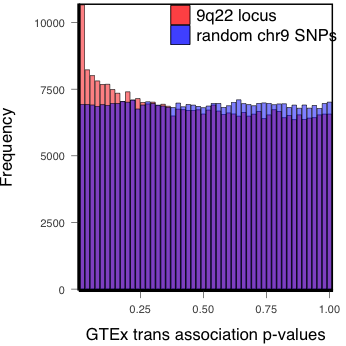

In [6]:
from IPython.display import Image
#proj_dir = '/Users/brian_jo/Desktop/Project/RNAseq_pipeline/'
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/thyroid/plots/thyroid_pval_hist.png', width=400)

A nice enrichment of trans signal is observed for this particular locus.

### Enrichment of trans-eQTLs among best cis-eQTLs

We look at our cis-subsetting run, and see if the best cis-eQTLs enrich the discovery of trans-eQTLs, in example tissues of subcutaneous adipose and skeletal muscle (7 and 6 trans-eQTLs below FDR 0.1, respectively).

In [ ]:
%%bash

Rscript /tigress/BEE/RNAseq/Analysis/Figures/manuscript_figures/subset_enrichment/subset_enrichment_plot_part1.R
Rscript /tigress/BEE/RNAseq/Analysis/Figures/manuscript_figures/subset_enrichment/subset_enrichment_plot_part2.R

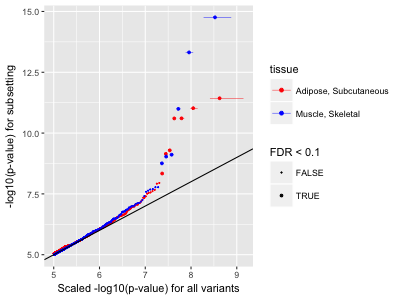

In [8]:
from IPython.display import Image
#proj_dir = '/Users/brian_jo/Desktop/Project/RNAseq_pipeline/'
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/subset_enrichment/plots/subset_enrichment_plot.png', width=500)

It is not surprising to find that trans-eQTLs are enriched among strongest cis-eQTLs - but in cases where there is not significant trans- signal in the tissue to begin with, we don't observe this enrichment.

### Location distribution of trans-eQTLs signals

We wanted to compare the location distribution trans-eQTLs signals for a few tissues, both before and after PEER correction, to see if aggressive PEER correction tends to reduce the overall association signal. Looking at a few plots before and after correction seems to suggest that this indeed is the case.

In [ ]:
%%bash

Rscript /tigress/BEE/RNAseq/Analysis/Figures/manuscript_figures/trans_eQTL_location/heatmap_pvalues.R

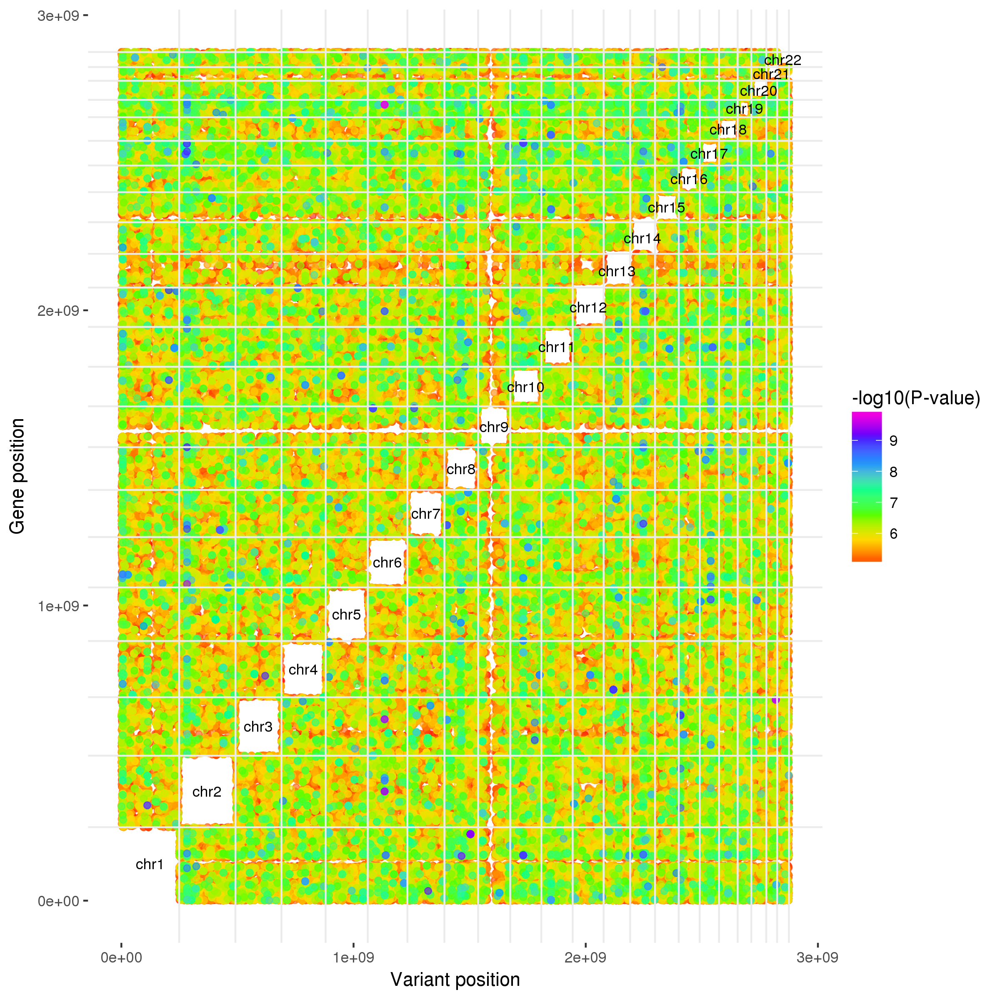

In [6]:
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/trans_eQTL_location/plots/vagina_no_peer_heatmap.png', width=500)

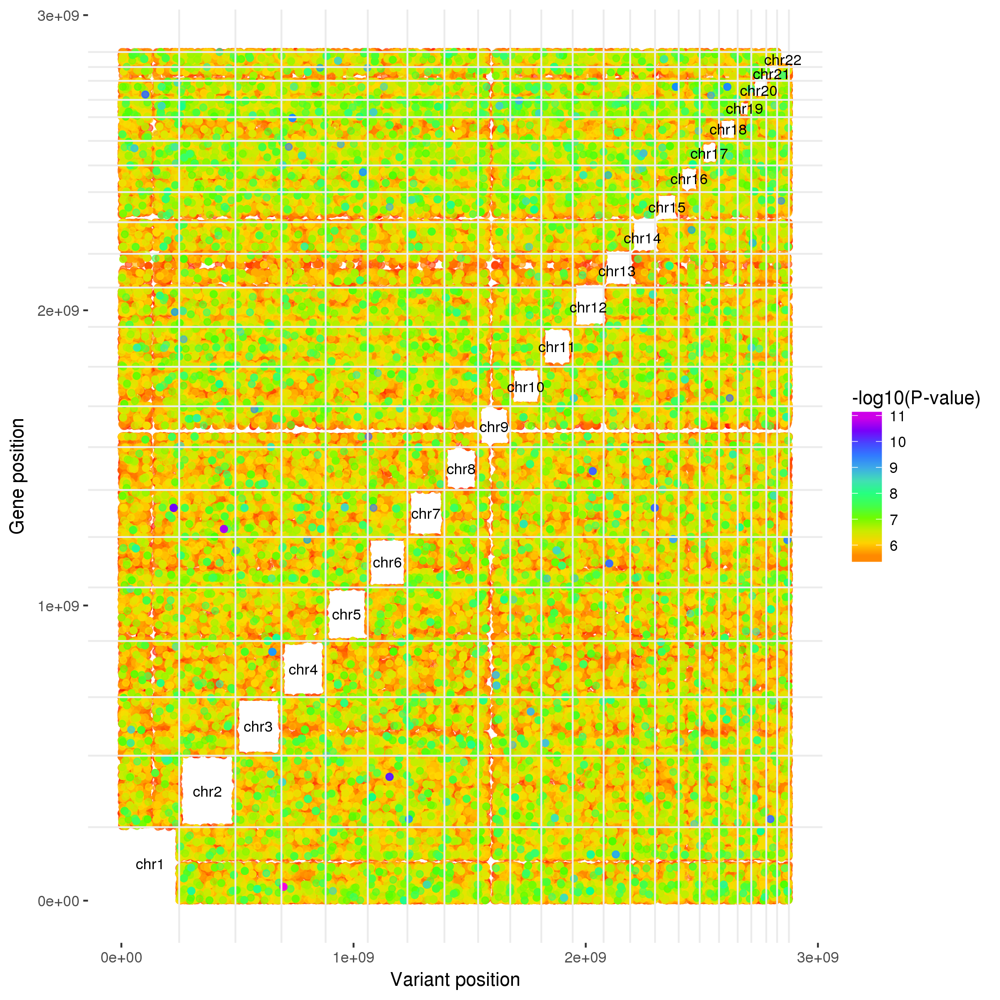

In [7]:
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/trans_eQTL_location/plots/vagina_15_peer_heatmap.png', width=500)

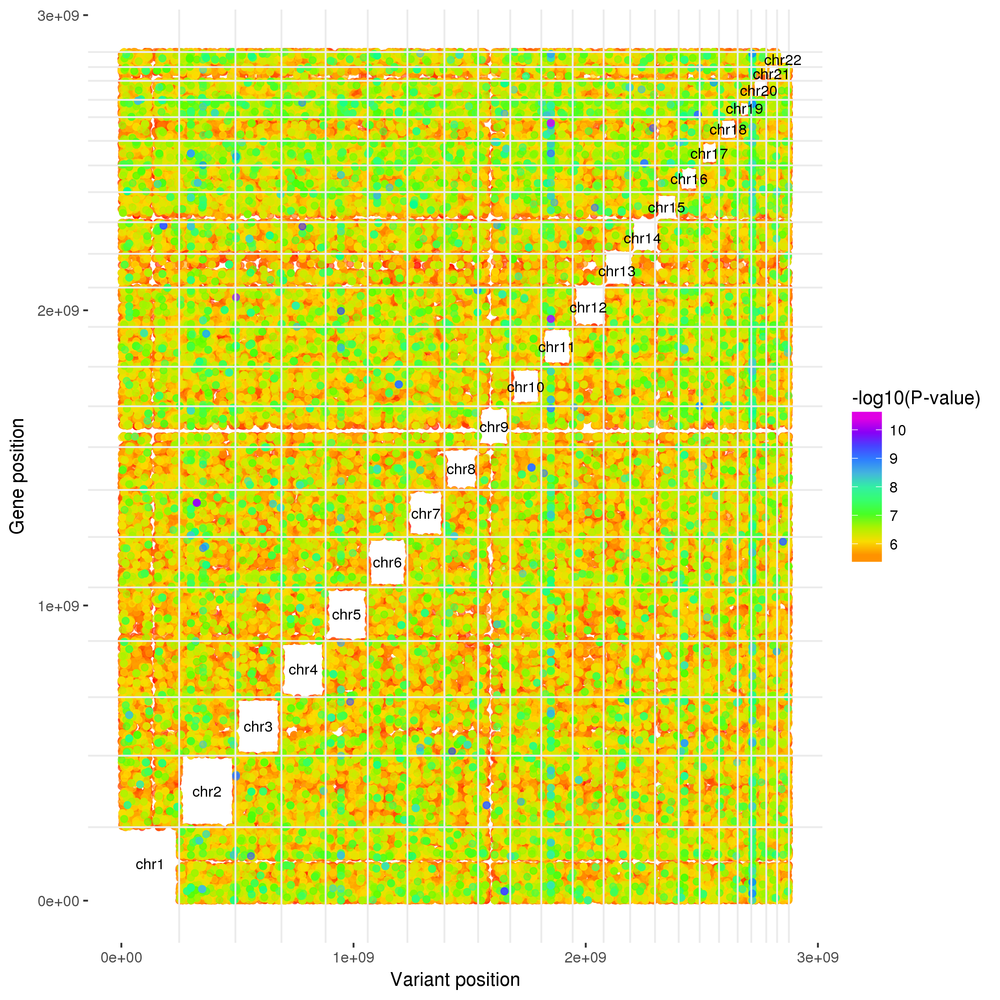

In [8]:
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/trans_eQTL_location/plots/stomach_no_peer_heatmap.png', width=500)

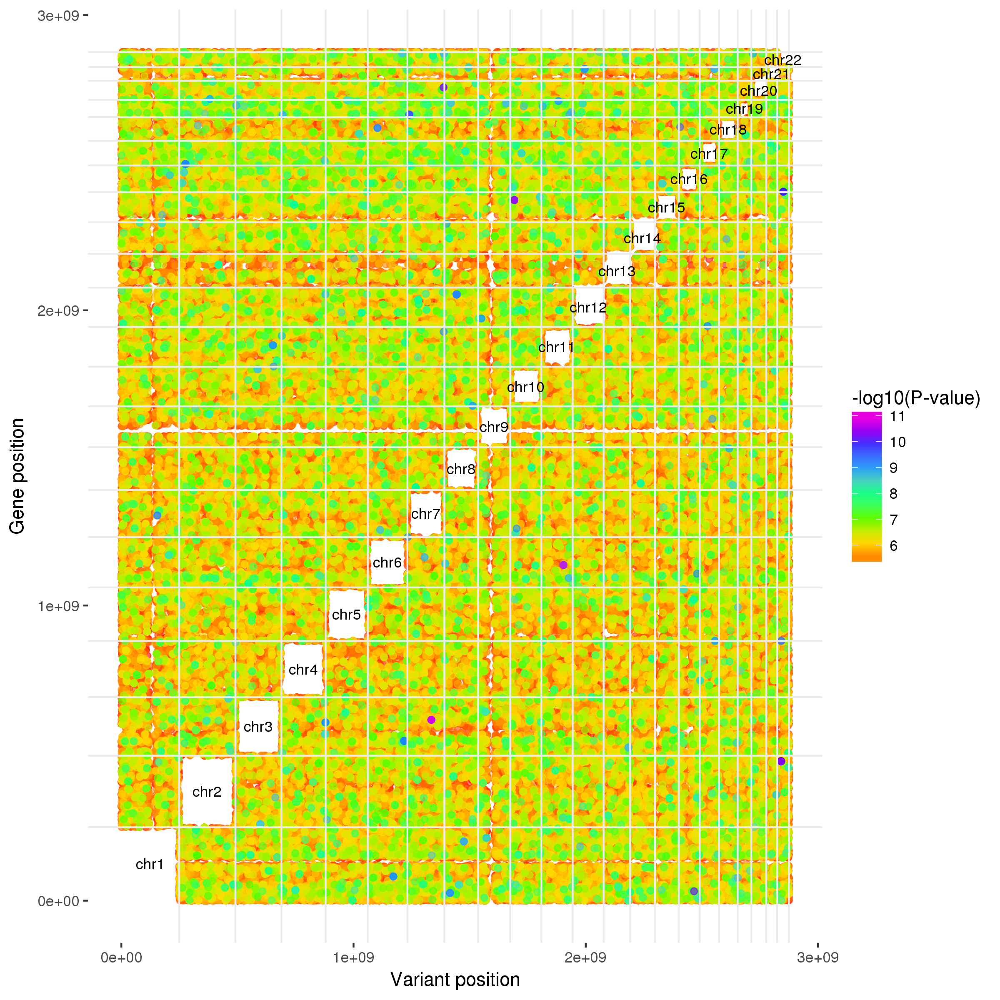

In [9]:
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/trans_eQTL_location/plots/stomach_30_peer_heatmap.png', width=500)

We can observe qualitatively that the vertical bands (showing high trans- signal) tend to disappear after aggressive PEER correction. However, the strongest p-values are not necessarily lower after correction, since PEER correction can also induce strong associations.

## 4. Additional analyses for the revision

This portion of the notebook reflects the additional analyses that we are running for the paper revision:

### Points of discussion

#### PEER factors - the actual trans-pipeline in section 1 has been changed due to this:

- Trans-eQTL t-statistics and detection hugely dependent upon the number of PEER factors used as covariates.
- Valid point raised in the reviews – we need to better justify which covariates we use and how aggressively we correct for them.
- How relevant are PEER factors in terms of tissue-specific genetic architecture?

#### AA/EA segregation runs

- Population-specific effect sizes calculated, and Ben has the results from meta-analysis.
- Caveat: Need to regress out the covariates before running population-specific effects, since for some tissues, the number of AA samples are less than the number of PEER factors.

#### MR runs

- I have the script to run MR on the preset list of trans SNP-gene pairs, and this is easily expandable to gene-gene pairs
- Null distribution – for now, simply have ‘permuted’ trans-gene expression (Plan to expand to entire gene-gene set, depending on how the results turn out).

#### Gene-level FDR calibration

- Based on the distribution of extreme values (Gumbel distribution), I fit a null distribution based on the extreme test statistics per gene for permuted gene expression values, and calculate the p-value (using one-sample Kolmogorov-Smirnov test) of drawing the extreme test statistic that we observe in our test set for each gene.


### 4.1 Effects of increasing PEER factors in terms of trans-eQTL detection

We want to see the effect of varying the number of PEER factors in the number of trans-eQTLs that we get, and what overall effects there are. The actual trans-eQTL mapping has been already completed in section 1 - we just need to turn them into plots to see what the effects are.

#### Brief question: are the PEER factors in the right order?

example tissue: Esophagus Mucosa - each row is the calculated FVU (https://en.wikipedia.org/wiki/Fraction_of_variance_unexplained) using the cumulative covariate matrix.
<code>
             [,1]            [,2]               
var_unexp_df "init"          "0.97551495262046" 
             "InferredCov1"  "0.841801504707677"
             "InferredCov2"  "0.744374062838224"
             "InferredCov3"  "0.674702452017034"
             "InferredCov4"  "0.618102109861026"
             "InferredCov5"  "0.579938164832358"
             "InferredCov7"  "0.545340252997059"
             "InferredCov6"  "0.511534793265388"
             "InferredCov8"  "0.488008088554447"
             "InferredCov9"  "0.468968998411351"
             "InferredCov10" "0.451030274850378"
             "InferredCov11" "0.433529201753421"
             "InferredCov12" "0.418485163393509"
             "InferredCov13" "0.406407746099954"
             "InferredCov14" "0.39532484265627" 
             "InferredCov15" "0.38437670524998" 
             "InferredCov16" "0.374500545965478"
             "InferredCov17" "0.364704869984138"
             "InferredCov18" "0.356047328096784"
             "InferredCov20" "0.34884780039369" 
             "InferredCov19" "0.34233342288598" 
             "InferredCov21" "0.335921151522745"
             "InferredCov22" "0.329836071985093"
             "InferredCov23" "0.323770455908298"
             "InferredCov24" "0.31865816730487" 
             "InferredCov25" "0.31363232649568" 
             "InferredCov26" "0.308665117261292"
             "InferredCov27" "0.304124098784607"
             "InferredCov29" "0.29979243483922" 
             "InferredCov30" "0.295604987700854"
             "InferredCov28" "0.291619082616769"
</code>

It generally seems to be the case in this tissue. (Init means C1-C3, gender and Platform)

As for thyroid, the order seems a little less consistent:

<code>
             [,1]            [,2]               
var_unexp_df "init"          "0.970099644585963"
             "InferredCov1"  "0.859521331972025"
             "InferredCov2"  "0.786863829999198"
             "InferredCov3"  "0.720482384426611"
             "InferredCov4"  "0.665185986273949"
             "InferredCov5"  "0.616900835143913"
             "InferredCov6"  "0.577130175073536"
             "InferredCov7"  "0.546322679125989"
             "InferredCov9"  "0.524753924504028"
             "InferredCov10" "0.504774104117652"
             "InferredCov8"  "0.485104145625882"
             "InferredCov11" "0.468518007265643"
             "InferredCov13" "0.45587211233011" 
             "InferredCov12" "0.44462482261654" 
             "InferredCov14" "0.433598193241331"
             "InferredCov15" "0.42368320830023" 
             "InferredCov16" "0.413919822198765"
             "InferredCov18" "0.405273865530299"
             "InferredCov17" "0.396799400773232"
             "InferredCov19" "0.389079468253191"
             "InferredCov21" "0.381989237016064"
             "InferredCov20" "0.375026535526701"
             "InferredCov22" "0.368299173415399"
             "InferredCov25" "0.362374300120753"
             "InferredCov24" "0.356724000178376"
             "InferredCov23" "0.351128559774183"
             "InferredCov26" "0.345649322719795"
             "InferredCov27" "0.340233912305478"
             "InferredCov28" "0.335300016608013"
             "InferredCov29" "0.330731574384024"
             "InferredCov31" "0.326345803739306"
             "InferredCov33" "0.322236115802779"
             "InferredCov34" "0.318213777267954"
             "InferredCov32" "0.314206389639169"
             "InferredCov35" "0.310268567148246"
             "InferredCov30" "0.306589872243253"
</code>

In order to get a better sense of how the trans mapping behaves as a function of PEER factors, let's set up new runs with PEER factors in increments of 5:

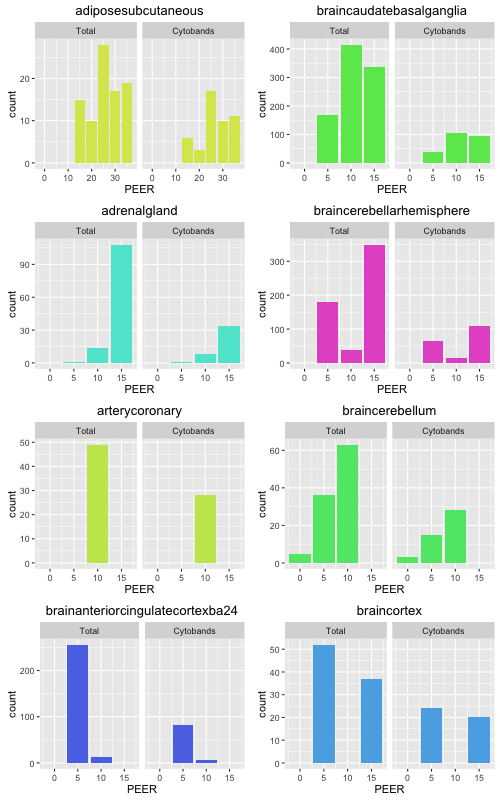

In [2]:
from IPython.display import Image
# proj_dir = '/Users/brian_jo/Desktop/Project/RNAseq_pipeline/'
Image(filename = proj_dir+'Analysis/Figures/trans_list_comparison/PEER_increments_1.png', width=500)

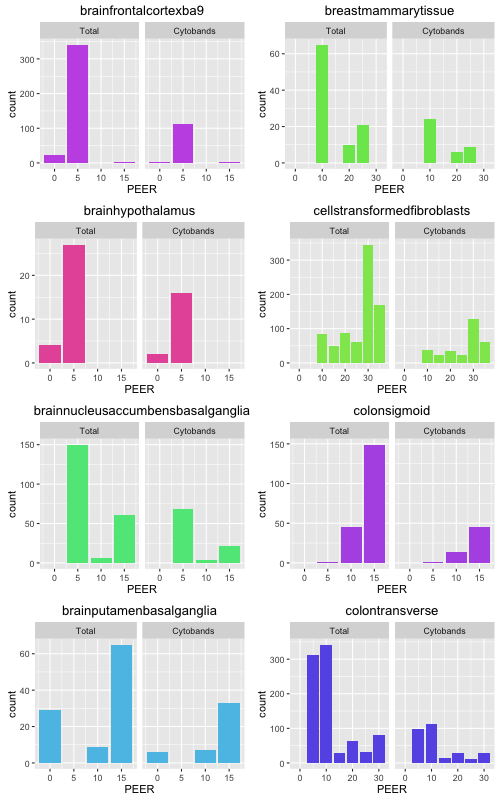

In [3]:
Image(filename = proj_dir+'Analysis/Figures/trans_list_comparison/PEER_increments_2.png', width=500)

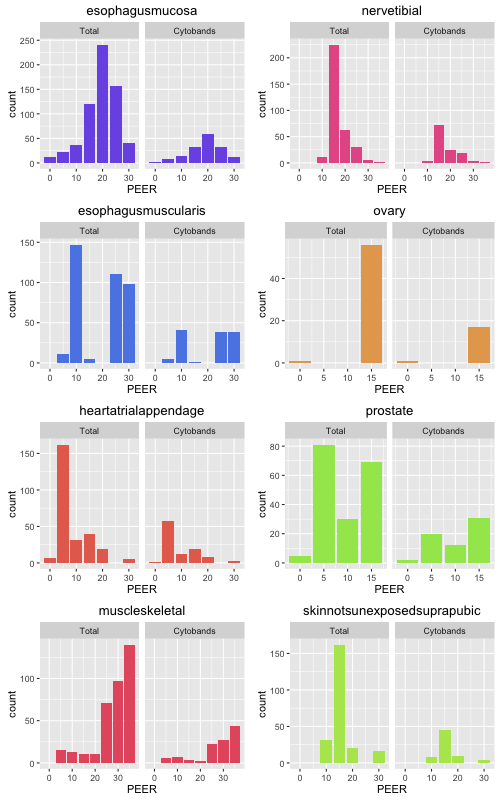

In [4]:
Image(filename = proj_dir+'Analysis/Figures/trans_list_comparison/PEER_increments_3.png', width=500)

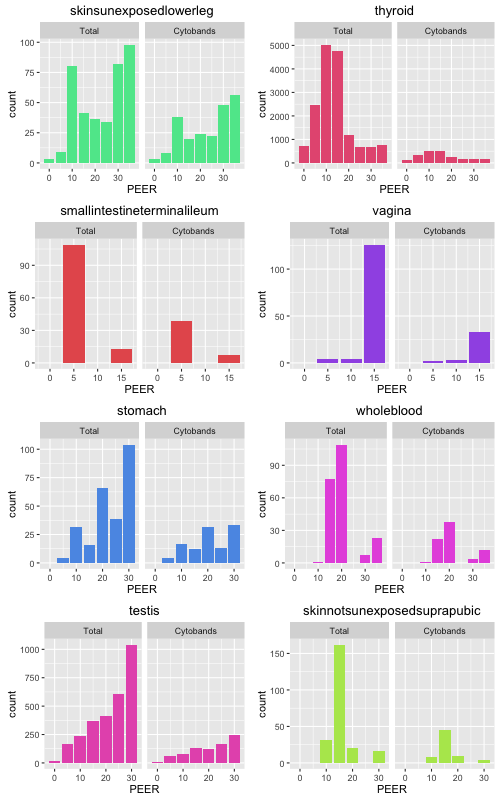

In [5]:
Image(filename = proj_dir+'Analysis/Figures/trans_list_comparison/PEER_increments_4.png', width=500)

### These figures show the number of trans-eQTL pairs, and the number of different loci (in terms of UCSC cytobands - refer to https://www.biostars.org/p/4355/ ) that have hits at FDR 0.5 for each tissue, with PEER factor increments of 5.

### I think with this we are able to infer a more consistent behavior across tissues - an 'inverted U-shape', where the number of trans hits increase, and then decrease (particularly visible in esophagus (mucosa), nerve (tibial) and thyroid examples.

### This result makes more sense - one interpretation may be that when it comes to trans, correcting for broad effects in expression first increases power by removing technical, environmental, and other confounding effects, but then starts removing real biological broad-sense signal.

### Therefore, given the PEER optimization procedure, it would make sense that the number of 'optimal' PEER factors for trans tends to be less than the number of PEER factors actually used, although we see counter-examples of this such as testis, where we don't see a drop-off yet.

### 4.2 AA/EA segregation runs for the trans hits



In [ ]:
%%bash

# Run specific trans- Matrix eqtl runs for these
python $proj/Scripts/eqtls/trans/gtex/matrix_eqtl_wrapper_preset_list.py \
/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/all-by-all/Final_trans_eQTL_list.txt \
/Data/Expression/gtex/hg19/GTEx_phs000424_v6p/normalized/ \
_nonverlapping_certain_autosomes_normalized.txt \
/Output/trans-mapping/gtex/MatrixEQTL/seg_runs_orthogonalize/ \
/Output/joblogs/trans-mapping/gtex/MatrixEQTL/seg_runs_orthogonalize/ \
trans_matrix_eqtl_seg_runs.R 2.5e8 1 all

Number of EA/AA samples for each tissue

<code>
adiposesubcutaneous    250    45
adiposevisceralomentum    160    24
adrenalgland    104    20
arteryaorta    173    22
arterycoronary    98    17
arterytibial    238    42
brainanteriorcingulatecortexba24    66    5
braincaudatebasalganglia    84    13
braincerebellarhemisphere    78    9
braincerebellum    90    11
braincortex    80    15
brainfrontalcortexba9    81    11
brainhippocampus    71    9
brainhypothalamus    73    7
brainnucleusaccumbensbasalganglia    79    11
brainputamenbasalganglia    70    10
breastmammarytissue    154    27
cellsebvtransformedlymphocytes    90    24
cellstransformedfibroblasts    226    43
colonsigmoid    113    10
colontransverse    143    24
esophagusgastroesophagealjunction    111    15
esophagusmucosa    212    27
esophagusmuscularis    189    26
heartatrialappendage    137    21
heartleftventricle    167    20
liver    84    12
lung    242    34
muscleskeletal    305    51
nervetibial    208    44
ovary    69    15
pancreas    125    22
pituitary    75    10
prostate    73    12
skinnotsunexposedsuprapubic    164    30
skinsunexposedlowerleg    257    41
smallintestineterminalileum    65    11
spleen    72    17
stomach    143    25
testis    132    21
thyroid    238    37
uterus    57    12
vagina    66    13
wholeblood    283    50
</code>

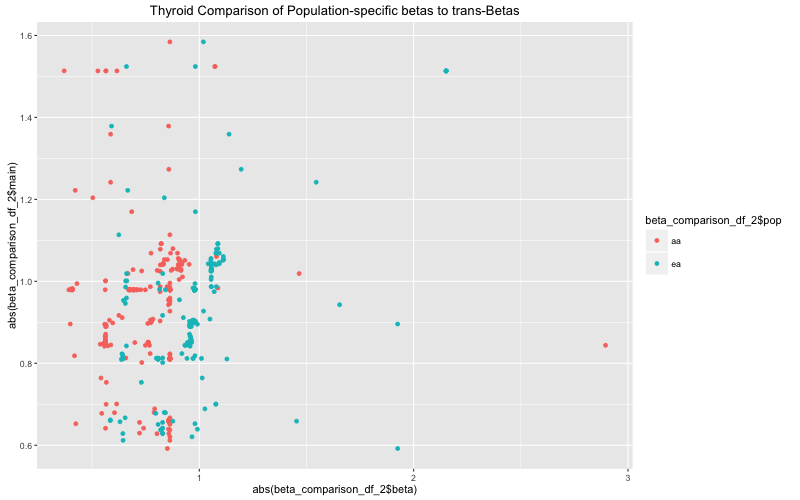

In [23]:
Image(filename = proj_dir+'Analysis/Figures/seg_run_explore/beta_pop_comparison.png', width=800)

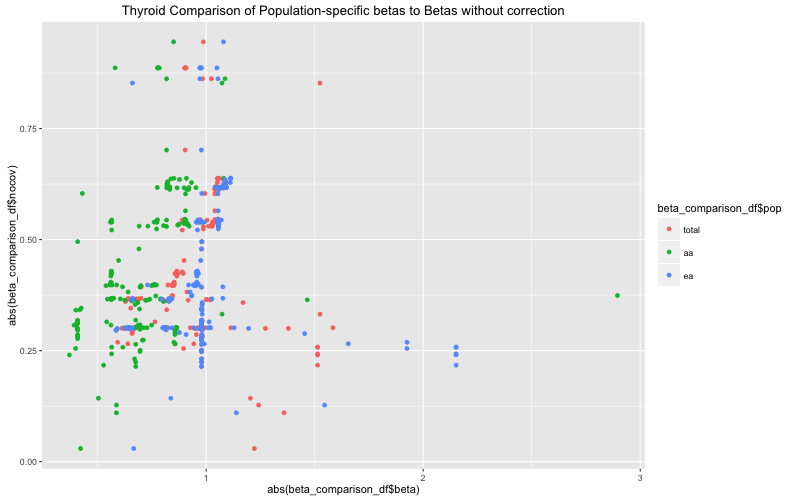

In [24]:
Image(filename = proj_dir+'Analysis/Figures/seg_run_explore/nocov_beta_comparison.png', width=800)

### 4.3 MR - Causal inference framework on GTEx data¶

#### MR_eQTL

In this section, we test an implementation of Mendelian Randomization, For more information about the underlying methodology, refer to this [article by Lawlor et al.](http://research.lunenfeld.ca/gwa_studies/files/file/GWAS/Sheehan_MR/Lawlorsim08.pdf)

In particular, the statistic for the strength of causal effect of the gene is calculated as below:

\begin{eqnarray}
t_{MR} &=& \frac {\beta_{MR}} {var(\beta_{MR})} \\
&\text{where:}& \\
\beta_{MR} &=& \frac { \hat\beta_{y,z}} {\hat\beta_{x,z}} \\
var(\beta_{MR}) &=& \sigma^2 (x^T P_z x)^{-1} \\
\sigma^2 &=& \frac {(y - x \beta_{MR})^T (y - x \beta_{MR})} {n - \nu} \\
P_z &=& z(z^Tz)^{-1}z^T \\
\end{eqnarray}

#### Process overview

The pipeline proceeds in a following fashion:

1. Obtain a subset of eQTLs that are both cis-eQTLs and trans-eQTLs (290 SNPs).
2. Obtain the following set of expression values:
    - Tissue-specific 'Causal' gene expression, with the covariates regressed out
    - Tissue-specific 'Effect' gene expression, with the covariates regressed out
    - Permuted tissue-specific 'Effect' gene expression, with the covariates regressed out
3. Run quick association tests with the genotypes and the three sets of expression values.
4. Calculate the MR Wald statistic (defined above) to see whether we get enrichment compared to null.

Below we have some example results from the cis-trans-eQTL MR run:

In [ ]:
%%bash

Rscript Analysis/Figures/manuscript_figures/MR_stats/cis_trans_eqtl_MR_analysis_post.R

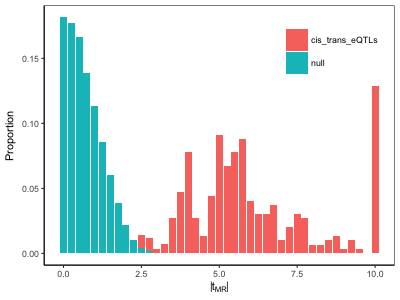

In [4]:
from IPython.display import Image
proj_dir = '/Users/brian_jo/Desktop/Project/RNAseq_pipeline/'
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/MR_stats/plots/MR_t_stats.png', width=500)

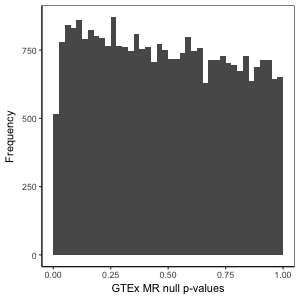

In [5]:
Image(filename = proj_dir+'Analysis/Figures/manuscript_figures/MR_stats/plots/MR_null_pval_hist.png', width=500)

### 4.4 Gene-level FDR calibration

First, let's compile the list of genes represented in our outputs, and select the extreme test statistic values (or lowest p-values) per gene.

In [ ]:
%%bash

Rscript /tigress/BEE/RNAseq/Scripts/misc/gtex/compile_gene_list.R /Output/trans-mapping/gtex/MatrixEQTL/all-by-all-PEER-increments/ /Output/trans-mapping/gtex/MatrixEQTL/gene_level_FDR/genes_represented/

The directory

<code>/tigress/BEE/RNAseq/Output/trans-mapping/gtex/MatrixEQTL/gene_level_FDR/genes_represented</code>

has the resulting files list the genes along with their most extreme test statistics and p-values. Then, output a similar data files using the permuted expression values:

In [ ]:
%%bash

python $proj/Scripts/eqtls/trans/gtex/consortium/trans_matrix_eqtl_wrapper.py \
/Data/Expression/gtex/hg19/GTEx_phs000424_v6p/normalized/ \
_v6p_consortium_autosomes_normalized.txt \
/Output/trans-mapping/gtex/MatrixEQTL/gene_level_FDR/ \
/Output/joblogs/trans-mapping/gtex/MatrixEQTL/gene_level_FDR/ \
trans_matrix_eqtl_null_geneFDR.R 2.5e8 10 32t

The directory

<code>/tigress/BEE/RNAseq/Output/trans-mapping/gtex/MatrixEQTL/gene_level_FDR/</code>

has the resulting data files that list the most extreme test statistic for each gene at each partition. Now, we can bring together the files to get the final list of null extreme values with permuted expression values.

There are three methods that we are comparing:

- Bonferroni Hack - take the min(1, extreme p-value * 1e6), and run Benjamini-Hochberg

<code> sapply(test_stats$pvalue, function(x) {min(x*1e6, 1)}) </code>

- Kolmogorov-Smirnov on the fitted null Gumbel distribution, and run Benjamini-Hochberg

<code> sapply(abs(test_stats$statistic), function(x) {ks.test(x, "pgumbel", mu, beta)$p.value}) </code>

- Calculate 1 - CDF of the fitted null Gumbel distribution, and run Benjamini-Hochberg

<code> sapply(abs(test_stats$statistic), function(x) {1 - pgumbel(x, location = mu, scale = beta)}) </code>

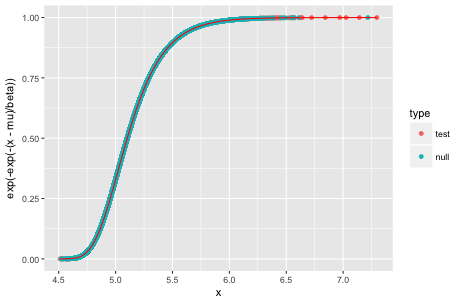

In [2]:
from IPython.display import Image
proj_dir = '/Users/brian_jo/Desktop/Project/RNAseq_pipeline/'
Image(filename = proj_dir+'Analysis/Figures/gene_level_FDR/fit_of_Gumbel.png', width=500)

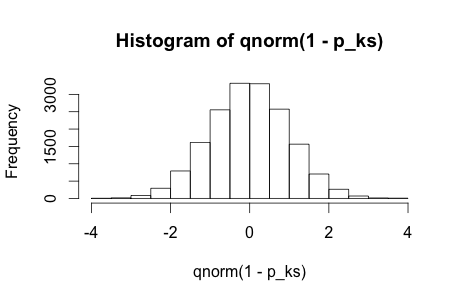

In [3]:
Image(filename = proj_dir+'Analysis/Figures/gene_level_FDR/p_ks_distribution.png', width=500)

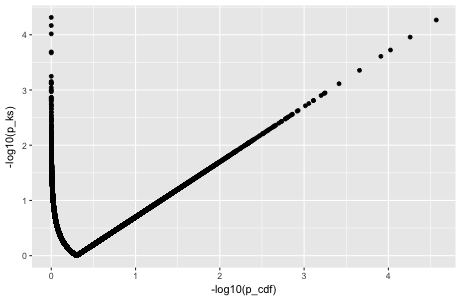

In [4]:
Image(filename = proj_dir+'Analysis/Figures/gene_level_FDR/qq_plot_cdf_ks.png', width=500)

Since Kolmogorov-Smirnov test calculates the p-value in a two-tailed fashion, we see this v-shaped plot when comparing CDF version and KS version.

In [ ]:
%%bash

python $proj/Scripts/eqtls/trans/gtex/consortium/MatrixEQTL_FDR_control_gene_level_wrapper.py

sh /tigress/BEE/RNAseq/Scripts/eqtls/trans/gtex/batch/MatrixEQTL_gene_FDR_control_wrapper.sh

This Rscript brings together the final gene-level FDR calibration and summarize the number of eGenes per tissue:

In [ ]:
%%Rscript

proj_dir = Sys.getenv('proj')

original_dir = paste0(proj_dir, '/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/gene_level_FDR/tissues/')
tissues = list.files(path=paste(original_dir))
main_trans_list = read.table(paste0(proj_dir, '/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/public_ftp/main_consortium_trans/trans-eQTLs_FDR-0.1.txt'), header=T) 

joint_10 = vector('list')
joint_20 = vector('list')
for (tissue in tissues) {

	tissue_name = strsplit(tissue, '\\.')[[1]][1]
	temp = read.table(paste0(original_dir, tissue_name, '.txt'), header=T, stringsAsFactors=F)
	temp = temp[c(1:100),]
    joint_10[[tissue_name]] = c(length(unique(main_trans_list[which(main_trans_list$tissue == tissue_name),]$gene)), sum(temp$qval_Uniform_Bonferroni < 0.1), sum(temp$qval_gene_FDR_ks < 0.1), sum(temp$qval_gene_FDR_cdf < 0.1))
    joint_20[[tissue_name]] = c(sum(temp$qval_Uniform_Bonferroni < 0.2), sum(temp$qval_gene_FDR_ks < 0.2), sum(temp$qval_gene_FDR_cdf < 0.2))

}

joint_10 = do.call('rbind', joint_10)
joint_20 = do.call('rbind', joint_20)

colnames(joint_10) = c('BH on SNP-gene Pairs', 'Uniform Bonferroni, 5e9', 'Gumbel fit, chi-sq', 'Gumbel fit, CDF')
colnames(joint_20) = c('Uniform Bonferroni, 5e9', 'Gumbel fit, chi-sq', 'Gumbel fit, CDF')

write.table(joint_10, file = paste0(proj_dir, '/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/gene_level_FDR/FDR_0.1.txt'), quote = F, sep='\t')
write.table(joint_20, file = paste0(proj_dir, '/Output/trans-mapping/gtex/trans-eQTLs/MatrixEQTL/gene_level_FDR/FDR_0.2.txt'), quote = F, sep='\t')